In [2]:
import scanpy as scp
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import os
from datetime import datetime
import json
import decoupler as dc

from auxiliar import *

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Select dataset

In [3]:
dataset = "data_processed"

In [4]:
dataset_name = f"full"

In [5]:
adatas = []
for file in np.sort([os.path.join(dataset,i) for i in os.listdir(dataset) if "rep" in i]):
    adata = scp.read_h5ad(file)
    adata.obs["sample"] = file.split(".")[0].split("adata_")[-1]
    adata.obs["condition"] = file.split(".")[0].split("adata_")[-1].split("_rep")[0]
    adatas.append(adata.copy())

adata = scp.concat(adatas)
adata.var = adatas[0].var.loc[:,["gene_id","gene_name","gene_type"]]
adata.var_names = adatas[0].var_names
adata.obs["sample"] = adata.obs["sample"].astype("category")
adata.obs["sample"] = adata.obs["sample"].cat.reorder_categories(np.sort(adata.obs["sample"].unique()))
adata.X = adata.layers["counts"].copy()

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [6]:
parameters = pd.read_csv("parameters_full.csv", index_col=0).loc[dataset_name, :].to_dict()
print("Parameters: ")
parameters

Parameters: 


{'n_top_genes': 2000,
 'n_top_genes.1': 2000,
 'n_pcs': 30,
 'n_neighbors': 15,
 'cell_cycle_regression': True,
 'resolutions': '[0.1,0.2,0.5,1]'}

In [7]:
if not os.path.exists(f"figures/{dataset_name}"):
    os.makedirs(f"figures/{dataset_name}")

if not os.path.exists(f"tables/{dataset_name}"):
    os.makedirs(f"tables/{dataset_name}")

if not os.path.exists('script_versions'):
    os.makedirs('script_versions')

# QC

Text(0.5, 1.0, 'Percentage of mitochondrial genes')

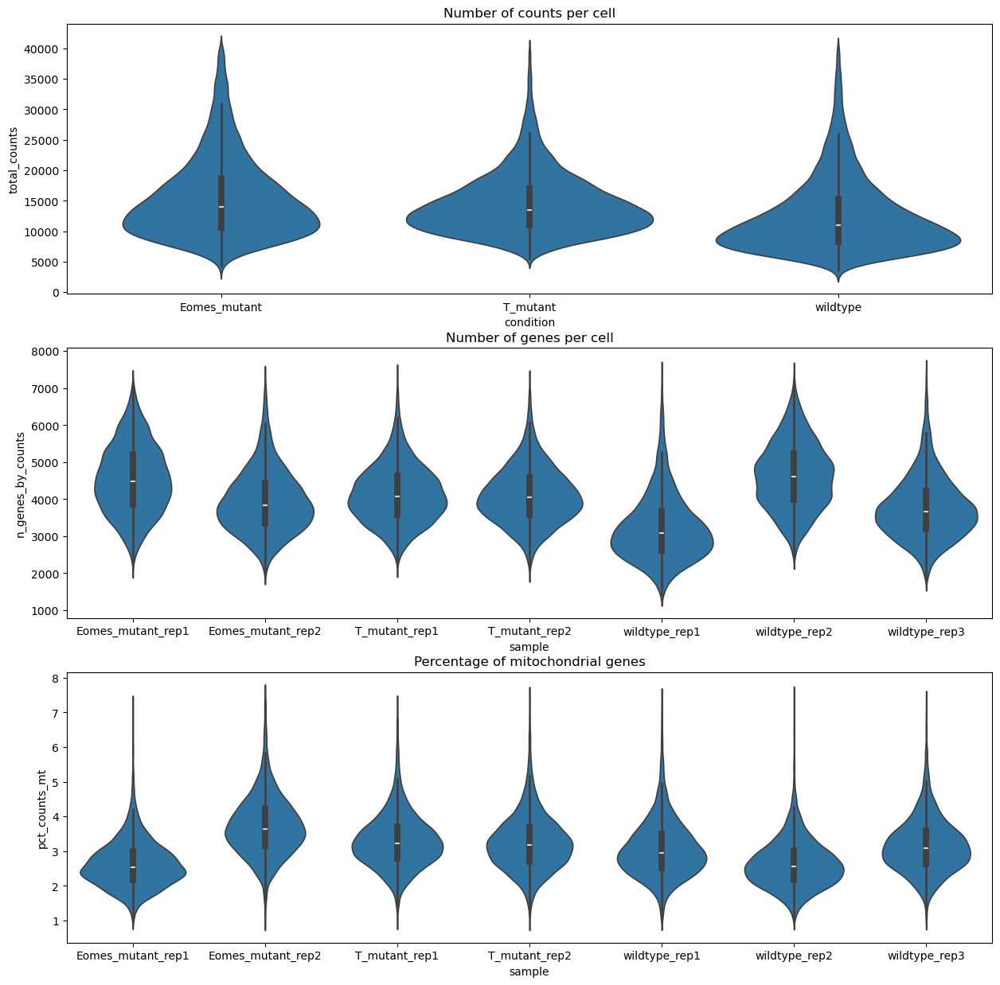

In [7]:
fig, ax = plt.subplots(3,1, figsize=(15,15))

sns.violinplot(data=adata.obs, x="condition", y="total_counts", ax=ax[0])
ax[0].set_title("Number of counts per cell")

sns.violinplot(data=adata.obs, x="sample", y="n_genes_by_counts", ax=ax[1])
ax[1].set_title("Number of genes per cell")

sns.violinplot(data=adata.obs, x="sample", y="pct_counts_mt", ax=ax[2])
ax[2].set_title("Percentage of mitochondrial genes")

# Normalization

In [8]:
scp.pp.normalize_total(adata)
scp.pp.log1p(adata)

# Dimensionality reduction

## Feature selection

In [9]:
scp.pp.highly_variable_genes(adata, n_top_genes=parameters["n_top_genes"])

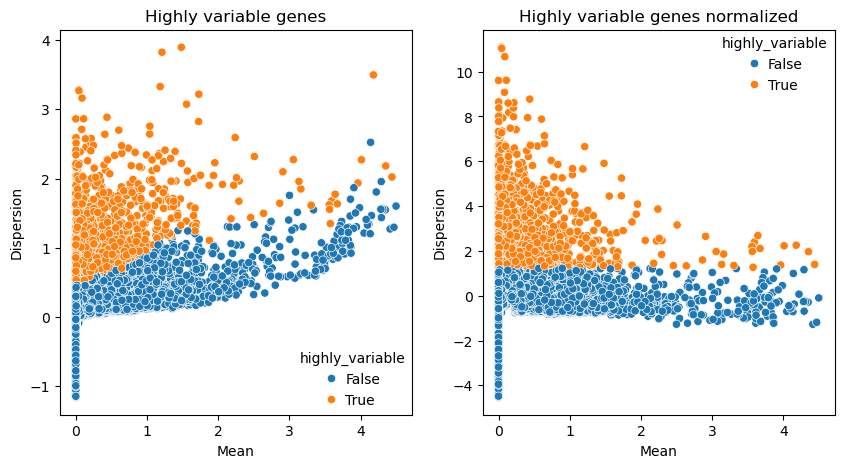

In [10]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

sns.scatterplot(x="means", y="dispersions", hue="highly_variable", data=adata.var, ax=ax[0])
ax[0].set_title("Highly variable genes")
ax[0].set_xlabel("Mean")
ax[0].set_ylabel("Dispersion")

sns.scatterplot(x="means", y="dispersions_norm", hue="highly_variable", data=adata.var, ax=ax[1])
ax[1].set_title("Highly variable genes normalized")
ax[1].set_xlabel("Mean")
ax[1].set_ylabel("Dispersion")

fig.savefig(f"figures/{dataset_name}/highly_variable_genes.png", bbox_inches="tight", transparent=True, dpi=300)

## PCA

In [11]:
scp.pp.pca(adata, n_comps=100, use_highly_variable=True)

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


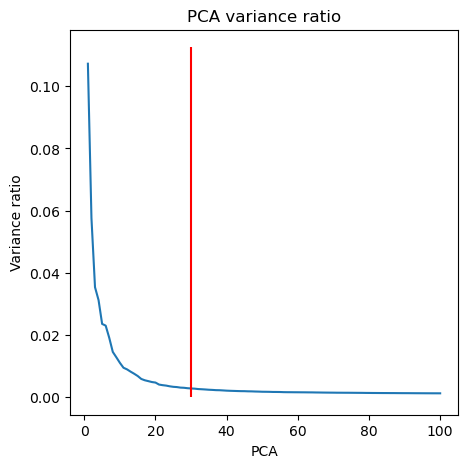

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))

sns.lineplot(x=range(1, 101), y=adata.uns["pca"]["variance_ratio"], ax=ax)
ax.vlines(parameters["n_pcs"], 0, ax.get_ylim()[1], color="red", label="min")
ax.set_title("PCA variance ratio")
ax.set_xlabel("PCA")
ax.set_ylabel("Variance ratio")

fig.savefig(f"figures/{dataset_name}/pca_variance_ratio.png", bbox_inches="tight", transparent=True, dpi=300)

In [13]:
scp.pp.pca(adata, n_comps=parameters["n_pcs"], use_highly_variable=True)

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


## UMAP

In [14]:
scp.pp.neighbors(adata, use_rep="X_pca", key_added="neighbors_pca", n_neighbors=parameters["n_neighbors"], n_pcs=parameters["n_pcs"])
scp.tl.umap(adata, neighbors_key="neighbors_pca")
adata.obsm["X_umap_pca"] = adata.obsm["X_umap"]

# Corrections

## Batch correction

In [15]:
scp.external.pp.harmony_integrate(adata, key="sample", basis="X_pca", adjusted_basis="X_pca_sample")

2025-09-18 10:56:00,794 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-09-18 10:56:00 | [INFO] Computing initial centroids with sklearn.KMeans...
2025-09-18 10:56:02,326 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-09-18 10:56:02 | [INFO] sklearn.KMeans initialization complete.
2025-09-18 10:56:02,396 - harmonypy - INFO - Iteration 1 of 10
2025-09-18 10:56:02 | [INFO] Iteration 1 of 10
2025-09-18 10:56:06,281 - harmonypy - INFO - Iteration 2 of 10
2025-09-18 10:56:06 | [INFO] Iteration 2 of 10
2025-09-18 10:56:10,296 - harmonypy - INFO - Iteration 3 of 10
2025-09-18 10:56:10 | [INFO] Iteration 3 of 10
2025-09-18 10:56:14,171 - harmonypy - INFO - Iteration 4 of 10
2025-09-18 10:56:14 | [INFO] Iteration 4 of 10
2025-09-18 10:56:17,996 - harmonypy - INFO - Converged after 4 iterations
2025-09-18 10:56:17 | [INFO] Converged after 4 iterations


In [16]:
scp.pp.neighbors(adata, use_rep="X_pca_sample", key_added="neighbors_pca_sample", n_neighbors=parameters["n_neighbors"], n_pcs=parameters["n_pcs"])
scp.tl.umap(adata, neighbors_key="neighbors_pca_sample")
adata.obsm["X_umap_pca_sample"] = adata.obsm["X_umap"]

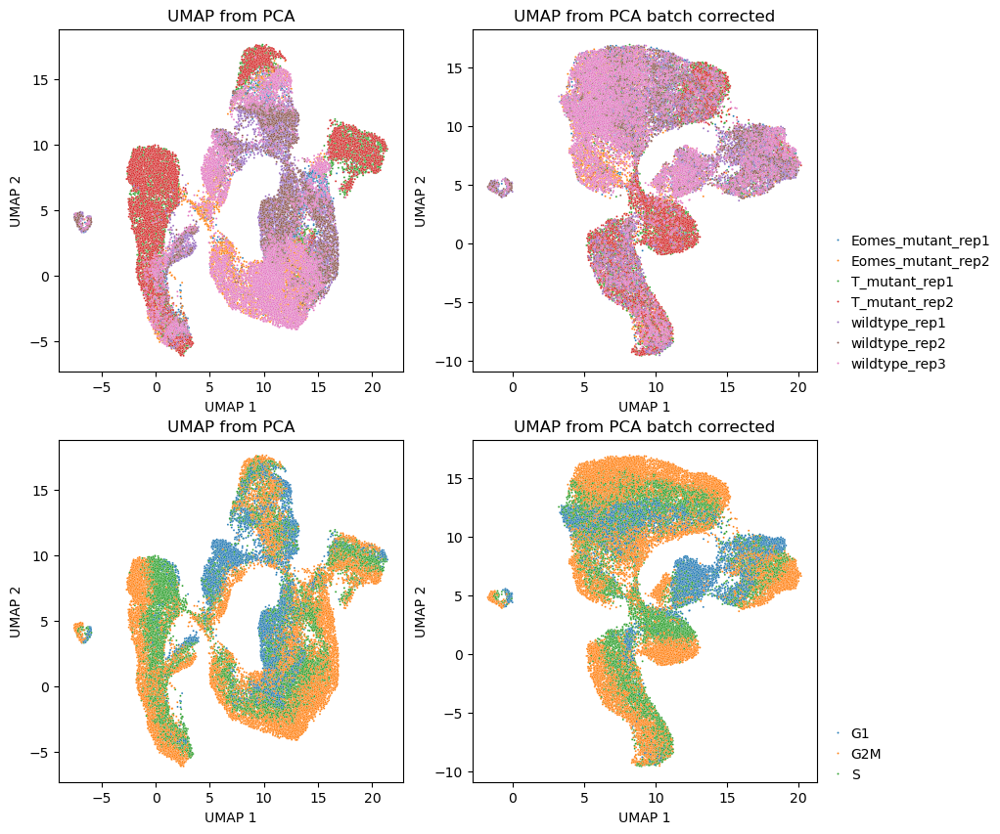

In [17]:
fig, ax = plt.subplots(2, 2, figsize=(10, 10))

X = adata.obsm["X_umap_pca"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["sample"], s=2, ax=ax[0,0])
ax[0,0].set_title("UMAP from PCA")
ax[0,0].set_xlabel("UMAP 1")
ax[0,0].set_ylabel("UMAP 2")
ax[0,0].get_legend().remove()

X = adata.obsm["X_umap_pca_sample"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["sample"], s=2, ax=ax[0,1])
ax[0,1].set_title("UMAP from PCA batch corrected")
ax[0,1].set_xlabel("UMAP 1")
ax[0,1].set_ylabel("UMAP 2")
ax[0,1].legend(loc=(1.04,0))

X = adata.obsm["X_umap_pca"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=2, ax=ax[1,0])
ax[1,0].set_title("UMAP from PCA")
ax[1,0].set_xlabel("UMAP 1")
ax[1,0].set_ylabel("UMAP 2")
ax[1,0].get_legend().remove()

X = adata.obsm["X_umap_pca_sample"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=2, ax=ax[1,1])
ax[1,1].set_title("UMAP from PCA batch corrected")
ax[1,1].set_xlabel("UMAP 1")
ax[1,1].set_ylabel("UMAP 2")
ax[1,1].legend(loc=(1.04,0))

fig.savefig(f"figures/{dataset_name}/umap_pca_vs_pca_sample.png", bbox_inches="tight", transparent=True, dpi=300)

## Cell cycle correction

In [18]:
s_genes = [i for i in pd.read_csv("cell_cycle_G1_S.txt",header=None).values.flatten() if i in adata.var_names]
g2m_genes = [i for i in pd.read_csv("cell_cycle_G2_M.txt",header=None).values.flatten() if i in adata.var_names]

cycle_genes = s_genes+g2m_genes

In [19]:
scp.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

scp.external.pp.harmony_integrate(adata, "phase", basis="X_pca_sample", adjusted_basis="X_pca_sample_phase")

2025-09-18 10:56:38,046 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-09-18 10:56:38 | [INFO] Computing initial centroids with sklearn.KMeans...
2025-09-18 10:56:39,327 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-09-18 10:56:39 | [INFO] sklearn.KMeans initialization complete.
2025-09-18 10:56:39,390 - harmonypy - INFO - Iteration 1 of 10
2025-09-18 10:56:39 | [INFO] Iteration 1 of 10
2025-09-18 10:56:43,055 - harmonypy - INFO - Iteration 2 of 10
2025-09-18 10:56:43 | [INFO] Iteration 2 of 10
2025-09-18 10:56:46,742 - harmonypy - INFO - Iteration 3 of 10
2025-09-18 10:56:46 | [INFO] Iteration 3 of 10
2025-09-18 10:56:50,507 - harmonypy - INFO - Converged after 3 iterations
2025-09-18 10:56:50 | [INFO] Converged after 3 iterations


In [20]:
scp.pp.neighbors(adata, use_rep="X_pca_sample_phase", key_added="neighbors_pca_sample_phase", n_neighbors=parameters["n_neighbors"], n_pcs=parameters["n_pcs"])
scp.tl.umap(adata, neighbors_key="neighbors_pca_sample_phase")
adata.obsm["X_umap_pca_sample_phase"] = adata.obsm["X_umap"]

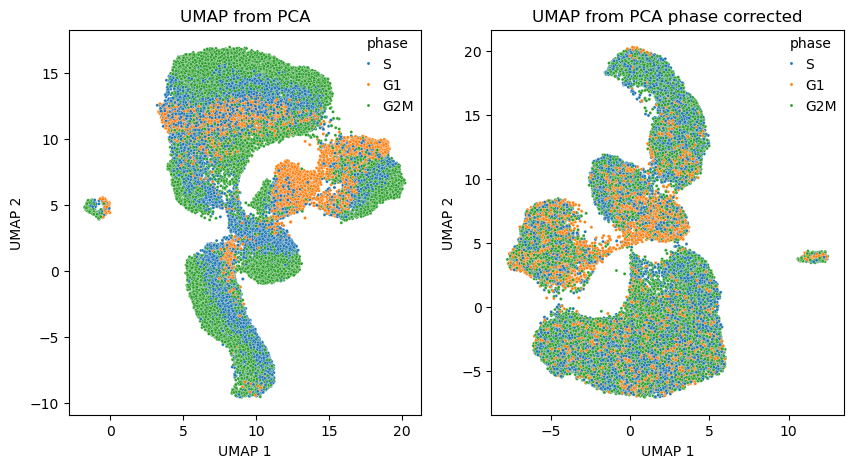

In [21]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

X = adata.obsm["X_umap_pca_sample"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=5, ax=ax[0])
ax[0].set_title("UMAP from PCA")
ax[0].set_xlabel("UMAP 1")
ax[0].set_ylabel("UMAP 2")

X = adata.obsm["X_umap_pca_sample_phase"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=5, ax=ax[1])
ax[1].set_title("UMAP from PCA phase corrected")
ax[1].set_xlabel("UMAP 1")
ax[1].set_ylabel("UMAP 2")

fig.savefig(f"figures/{dataset_name}/umap_pca_vs_pca_phase.png", bbox_inches="tight", transparent=True, dpi=300)

In [22]:
if parameters["cell_cycle_regression"]:
    repr = "pca_sample_phase"
else:
    repr = "pca_sample"

## Plots highlight samples

In [23]:
adata = scp.read(f"data_processed/adata_{dataset_name}.h5ad")

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [24]:
adata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,doublet_score,predicted_doublet,S_score,G2M_score,phase,leiden_0.5,sample,condition,leiden_0.1,leiden_0.2,leiden_1
257,4938,20678.0,596.0,2.882290,0.034921,False,0.388731,0.212975,S,1,Eomes_mutant_rep1,Eomes_mutant,0,0,8
555,3616,11482.0,262.0,2.281832,0.021298,False,-0.102343,-0.244258,G1,1,Eomes_mutant_rep1,Eomes_mutant,0,0,6
616,4766,17295.0,290.0,1.676785,0.026172,False,0.516578,-0.114396,S,1,Eomes_mutant_rep1,Eomes_mutant,0,0,8
962,3420,11228.0,307.0,2.734236,0.017241,False,-0.041819,0.048093,G2M,2,Eomes_mutant_rep1,Eomes_mutant,3,3,0
1214,3731,15252.0,287.0,1.881721,0.036411,False,0.167079,0.262295,G2M,5,Eomes_mutant_rep1,Eomes_mutant,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921296,3440,8962.0,413.0,4.608346,0.049447,False,-0.018575,0.503412,G2M,0,wildtype_rep3,wildtype,0,1,1
921301,5333,20459.0,672.0,3.284618,0.067821,False,0.386001,0.196498,S,1,wildtype_rep3,wildtype,0,0,6
921497,7161,34902.0,1213.0,3.475446,0.058670,False,0.050416,0.262632,G2M,6,wildtype_rep3,wildtype,1,2,7
921765,3242,8943.0,337.0,3.768310,0.018842,False,0.075173,-0.144147,S,1,wildtype_rep3,wildtype,0,0,8


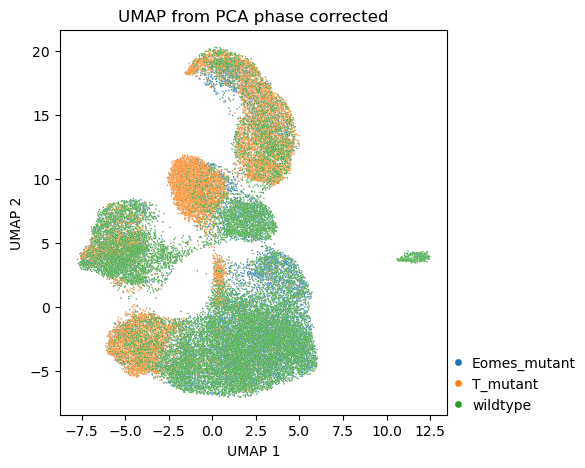

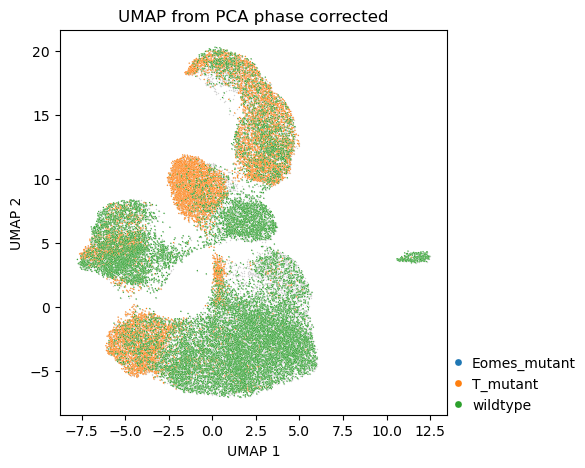

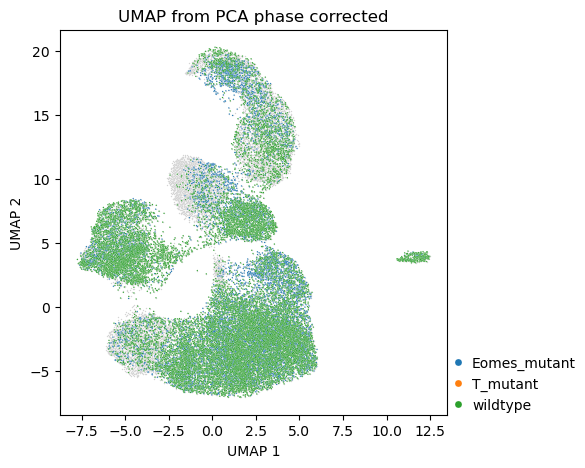

In [25]:
highlight_clusters = [
    ("Eomes_mutant", "T_mutant", "wildtype"),
    ("T_mutant", "wildtype"),
    ("Eomes_mutant", "wildtype"),
    ]

for i in highlight_clusters:
    
    X = adata.obsm["X_umap_pca_sample_phase"]
    highlight = adata.obs["condition"].isin(i).values
    
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))

    sns.scatterplot(x=X[:, 0], y=X[:, 1], color="lightgray", s=1, ax=ax)
    sns.scatterplot(x=X[highlight, 0], y=X[highlight, 1], hue=adata.obs["condition"].values[highlight], s=1, ax=ax)
    ax.set_title("UMAP from PCA phase corrected")
    ax.set_xlabel("UMAP 1")
    ax.set_ylabel("UMAP 2")
    ax.legend(fontsize=10, loc=(1.01,0.005), markerscale=5)

    fig.savefig(f"figures/{dataset_name}/umap_pca_vs_pca_condition_{i}.png", bbox_inches="tight", transparent=True, dpi=300)

# Clustering

In [26]:
parameters["resolutions"] = eval(parameters["resolutions"])

In [27]:
for resolution in parameters["resolutions"]:
    scp.tl.leiden(adata, neighbors_key=f"neighbors_{repr}", resolution=resolution, key_added=f"leiden_{resolution}")

/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_30097/3296185812.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  scp.tl.leiden(adata, neighbors_key=f"neighbors_{repr}", resolution=resolution, key_added=f"leiden_{resolution}")


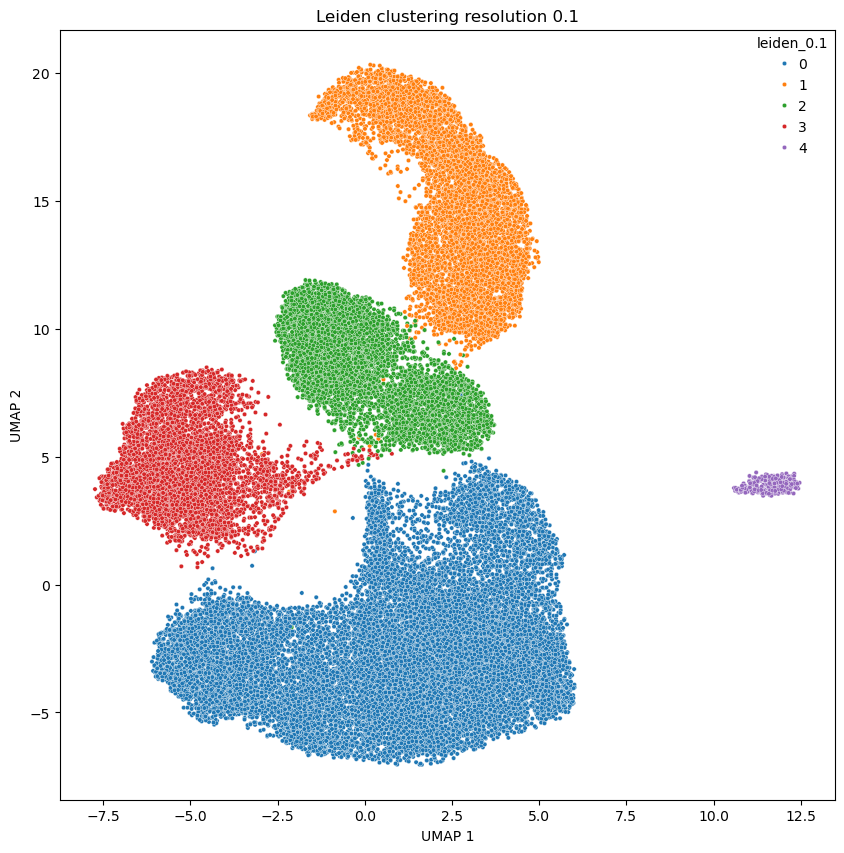

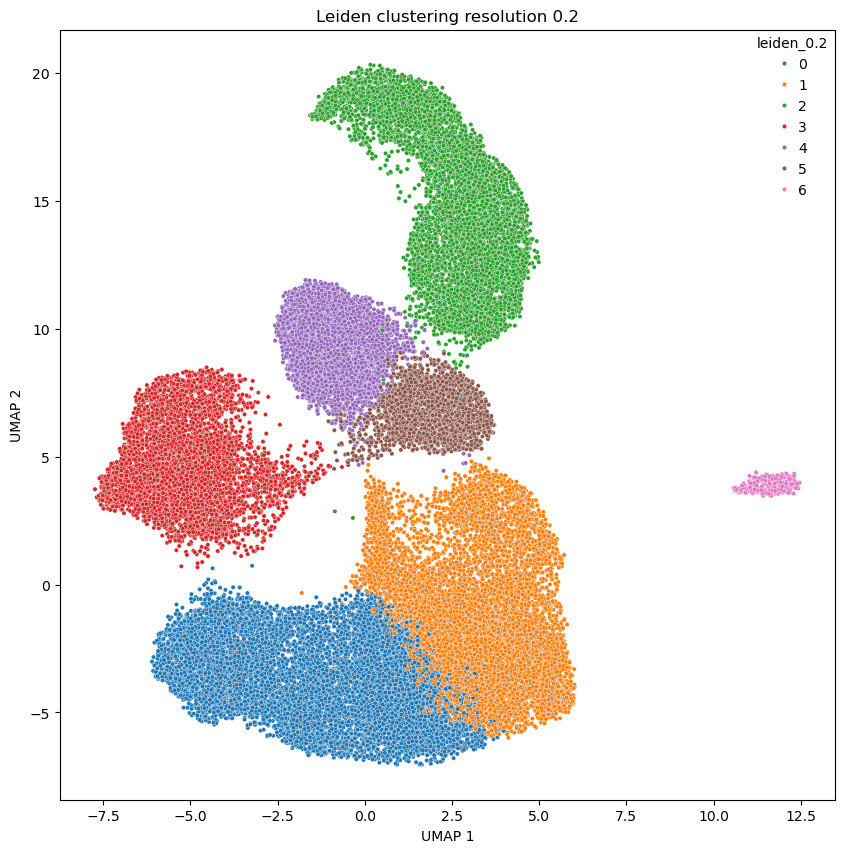

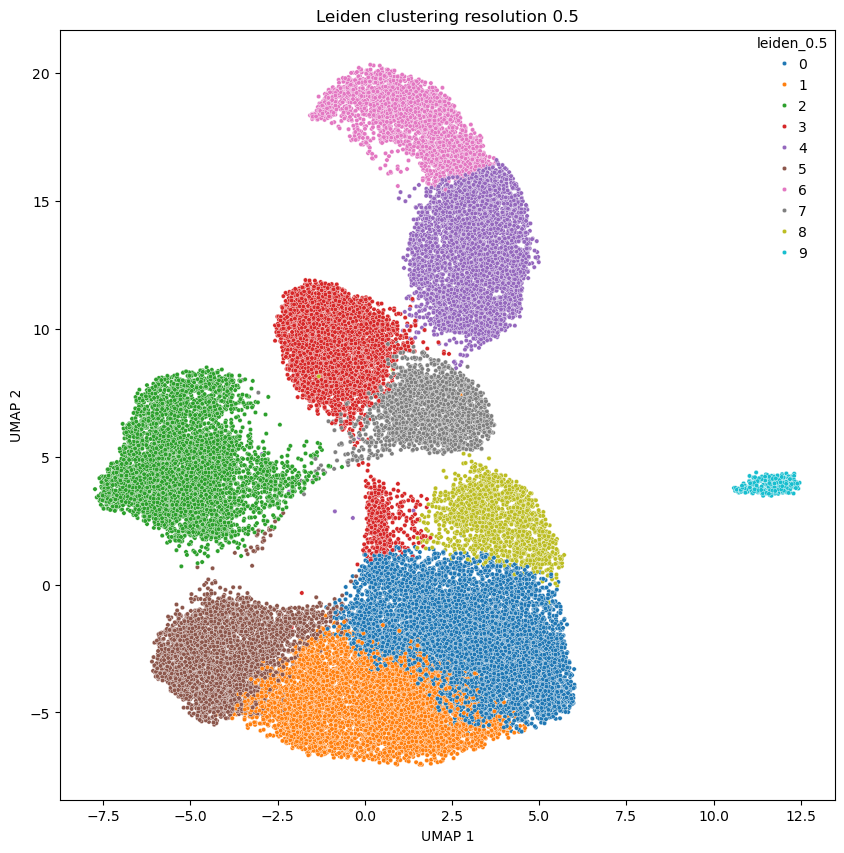

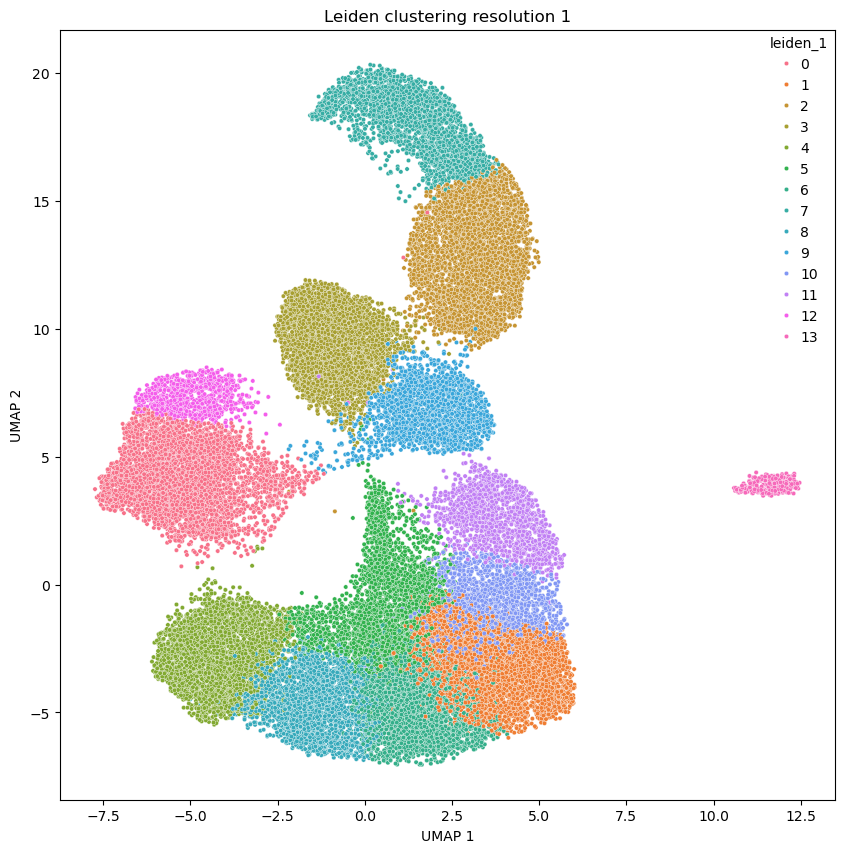

In [28]:
for resolution in parameters["resolutions"]:
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))

    X = adata.obsm[f"X_umap_{repr}"]
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs[f"leiden_{resolution}"], s=10, ax=ax)
    ax.set_title(f"Leiden clustering resolution {resolution}")
    ax.set_xlabel("UMAP 1")
    ax.set_ylabel("UMAP 2")

    fig.savefig(f"figures/{dataset_name}/leiden_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Markers

## Dotplot

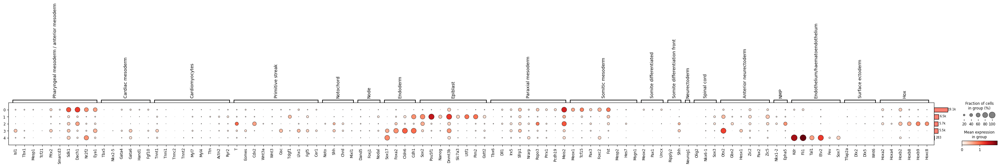

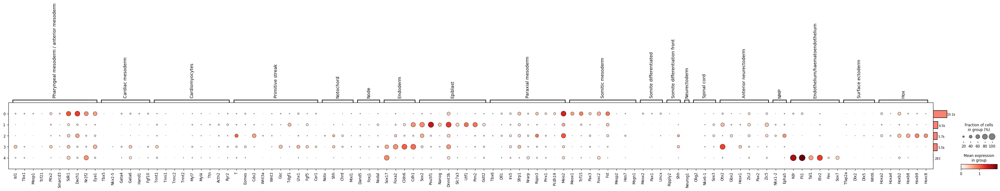

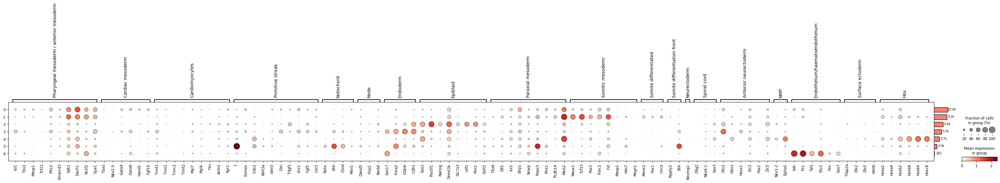

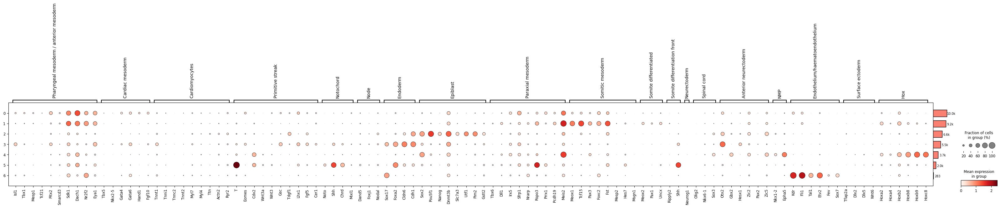

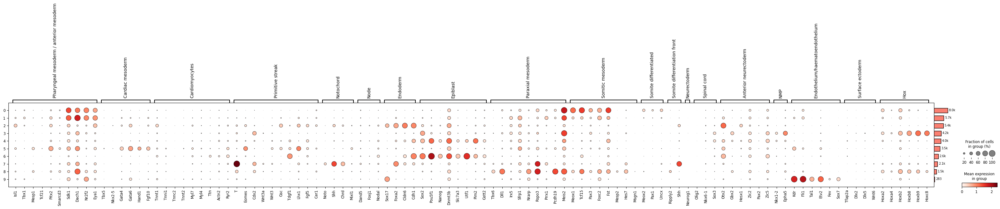

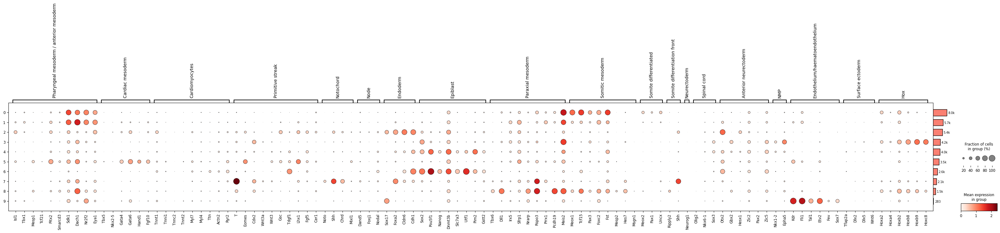

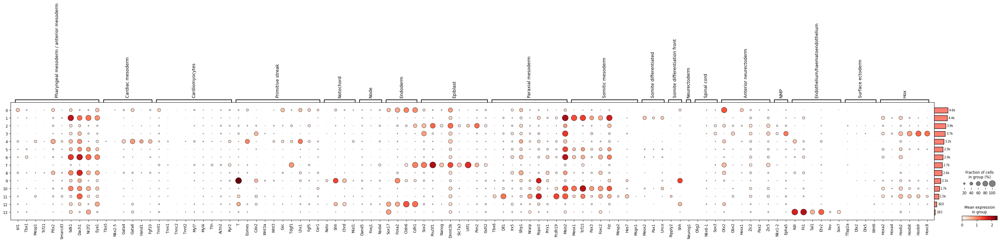

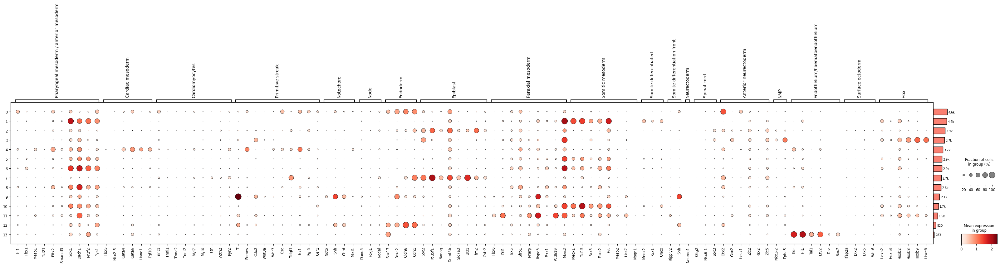

In [29]:
genes = {}
d = pd.read_csv("annotations.csv", header=None, sep=";")
for i in range(d.shape[0]):
    n = d.iloc[i,0]
    g = d.iloc[i,1]
    genes[n] = [j for j in (g.replace(" ","").replace("\t","").split(","))]

for resolution in parameters["resolutions"]:
    dp = scp.pl.dotplot(adata,var_names=genes,groupby=f"leiden_{resolution}", return_fig=True)
    dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

    dp.savefig(f"figures/{dataset_name}/markers_dotplot_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

## Heatmap rescaled

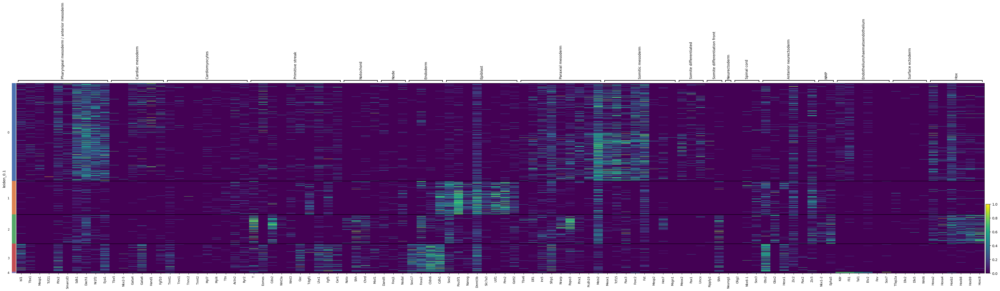

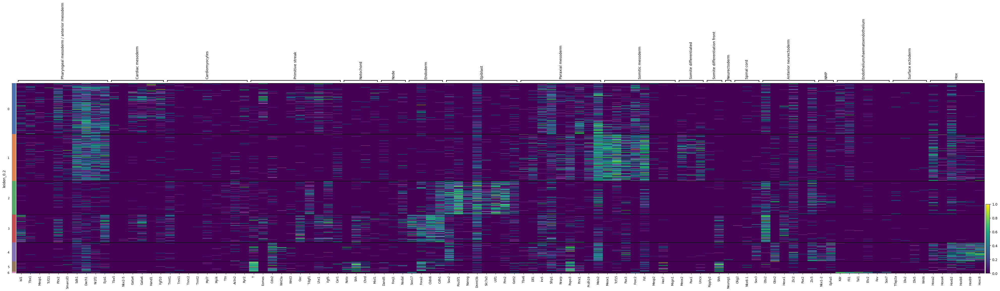

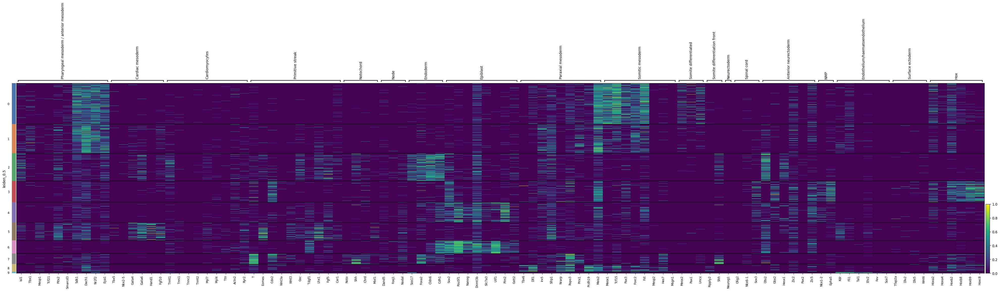

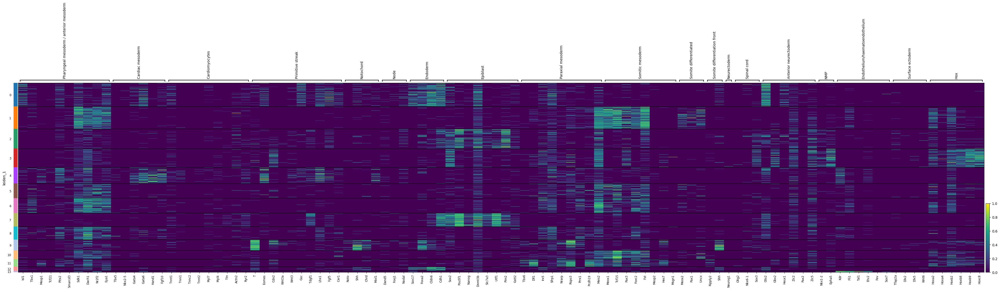

In [30]:
genes = {}
d = pd.read_csv("annotations.csv", header=None, sep=";")
for i in range(d.shape[0]):
    n = d.iloc[i,0]
    g = d.iloc[i,1]
    genes[n] = [j for j in (g.replace(" ","").replace("\t","").split(","))]

for resolution in parameters["resolutions"]:
    
    fig, dp = heatmap(adata,var_names=genes,groupby=f"leiden_{resolution}", standard_scale="var", figsize=(50,10), show_gene_labels=True, show=False)

    fig.savefig(f"figures/{dataset_name}/markers_heatmap_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Differential expression

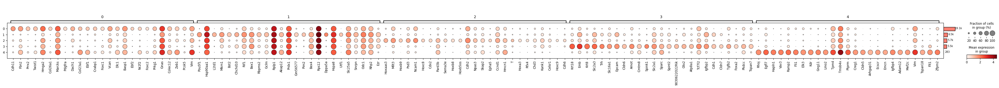

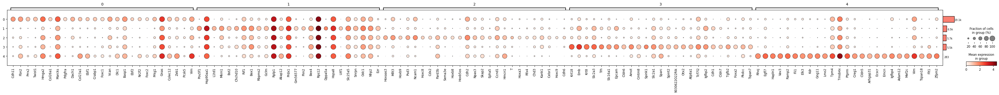

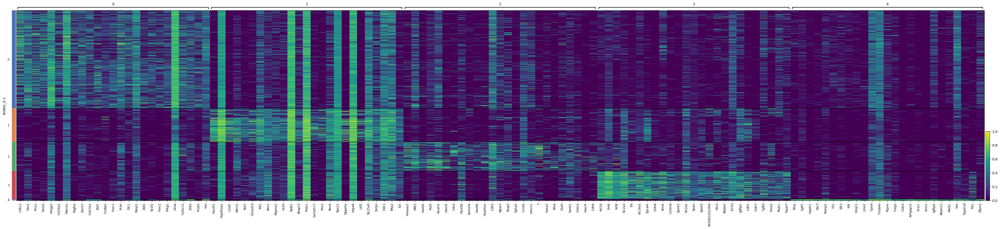

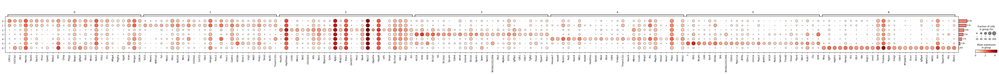

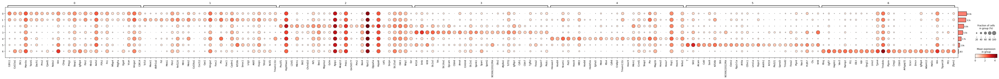

...

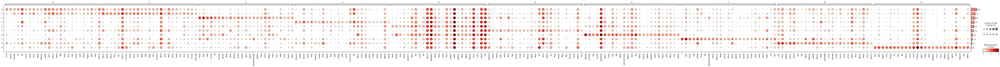

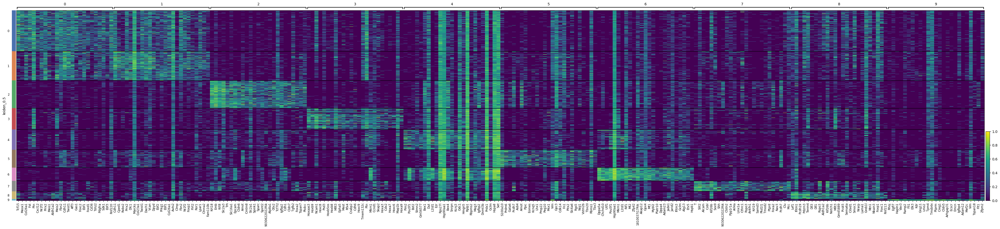

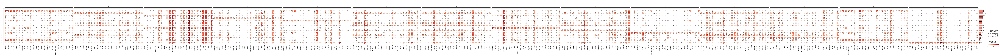

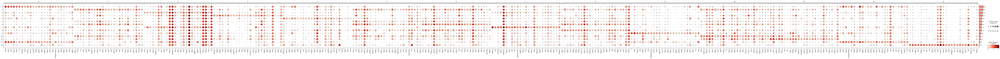

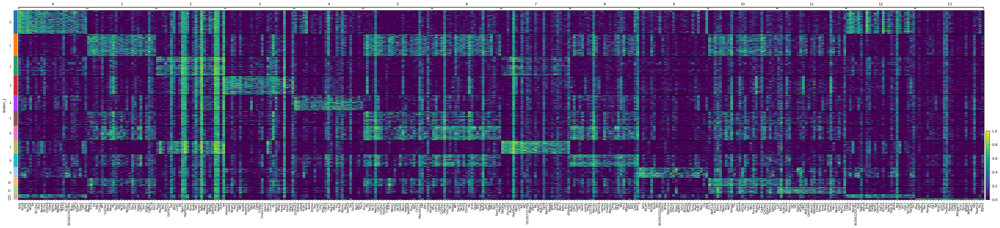

In [31]:
adata.layers["logcounts"] = adata.layers["counts"].log1p()
for resolution in parameters["resolutions"]:
    scp.tl.rank_genes_groups(adata, groupby=f"leiden_{resolution}", method="wilcoxon", layer="logcounts")

    with pd.ExcelWriter(f"tables/{dataset_name}/leiden_{resolution}.xlsx") as writer:
        for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
            genes = adata.uns["rank_genes_groups"]["names"][f"{cluster}"]
            scores = adata.uns["rank_genes_groups"]["scores"][f"{cluster}"]
            logfoldchanges = adata.uns["rank_genes_groups"]["logfoldchanges"][f"{cluster}"]
            pvals = adata.uns["rank_genes_groups"]["pvals"][f"{cluster}"]
            pvals_adj = adata.uns["rank_genes_groups"]["pvals_adj"][f"{cluster}"]
            df = pd.DataFrame({"gene": genes, "score": scores, "logfoldchange": logfoldchanges, "pval": pvals, "pval_adj": pvals_adj})
            df.to_excel(writer, sheet_name=f"cluster_{cluster}", index=False)

    genes = {}
    for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
        genes[cluster] = adata.uns["rank_genes_groups"]["names"][f"{cluster}"][:25]

    dp = scp.pl.dotplot(adata,var_names=genes,groupby=f"leiden_{resolution}", return_fig=True)
    dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()
    dp.savefig(f"figures/{dataset_name}/DE_dotplot_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

    fig, dp = heatmap(adata,var_names=genes,groupby=f"leiden_{resolution}", standard_scale="var", figsize=(50,10), show_gene_labels=True, show=False)
    fig.savefig(f"figures/{dataset_name}/DE_heatmap_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)


# Differential expression

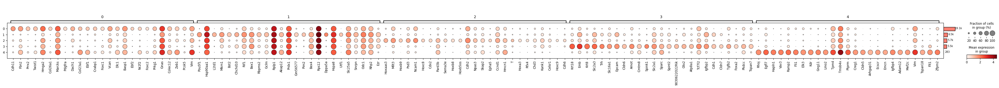

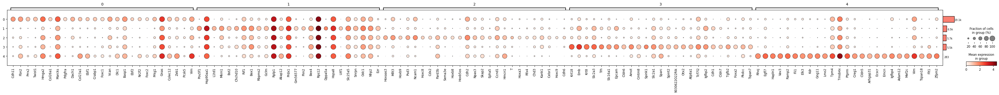

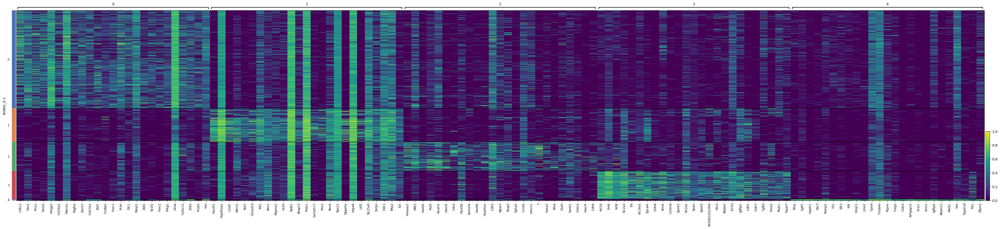

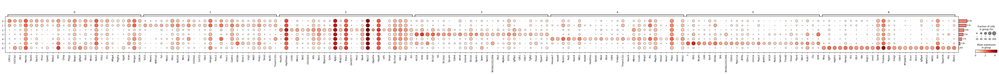

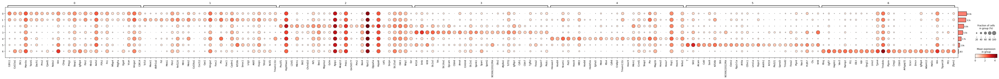

...

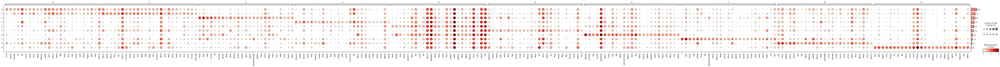

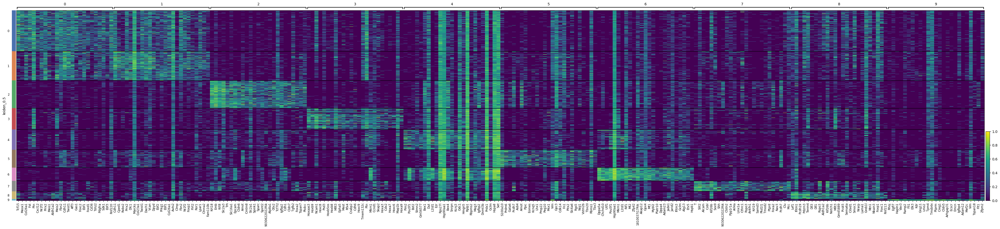

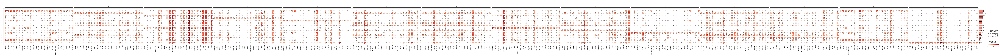

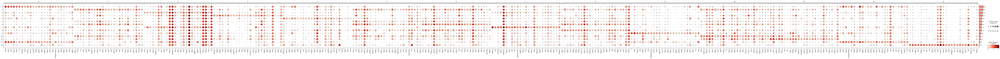

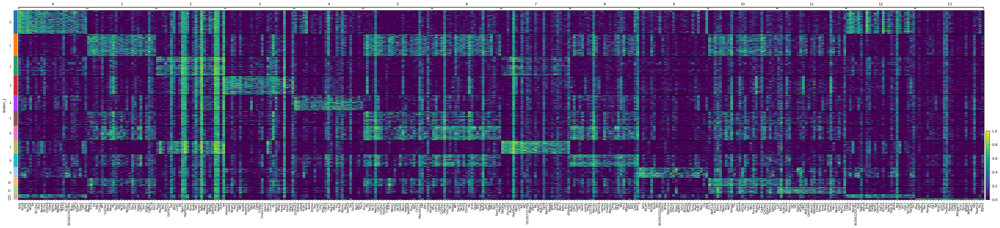

In [32]:
adata.layers["logcounts"] = adata.layers["counts"].log1p()
for resolution in parameters["resolutions"]:
    scp.tl.rank_genes_groups(adata, groupby=f"leiden_{resolution}", method="wilcoxon", layer="logcounts")

    with pd.ExcelWriter(f"tables/{dataset_name}/leiden_{resolution}.xlsx") as writer:
        for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
            genes = adata.uns["rank_genes_groups"]["names"][f"{cluster}"]
            scores = adata.uns["rank_genes_groups"]["scores"][f"{cluster}"]
            logfoldchanges = adata.uns["rank_genes_groups"]["logfoldchanges"][f"{cluster}"]
            pvals = adata.uns["rank_genes_groups"]["pvals"][f"{cluster}"]
            pvals_adj = adata.uns["rank_genes_groups"]["pvals_adj"][f"{cluster}"]
            df = pd.DataFrame({"gene": genes, "score": scores, "logfoldchange": logfoldchanges, "pval": pvals, "pval_adj": pvals_adj})
            df.to_excel(writer, sheet_name=f"cluster_{cluster}", index=False)

    genes = {}
    for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
        genes[cluster] = adata.uns["rank_genes_groups"]["names"][f"{cluster}"][:25]

    dp = scp.pl.dotplot(adata,var_names=genes,groupby=f"leiden_{resolution}", return_fig=True)
    dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()
    dp.savefig(f"figures/{dataset_name}/DE_dotplot_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

    fig, dp = heatmap(adata,var_names=genes,groupby=f"leiden_{resolution}", standard_scale="var", figsize=(50,10), show_gene_labels=True, show=False)
    fig.savefig(f"figures/{dataset_name}/DE_heatmap_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)


# Density by sample

/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_30097/3709163369.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = adata.obs.groupby(["sample", f"leiden_{resolution}"]).size().unstack(fill_value=0)
2025-09-18 11:07:14 | [INFO] Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-09-18 11:07:14 | [INFO] Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_30097/3709163369.py:3: FutureWarning: The default of observed=False is deprecated a

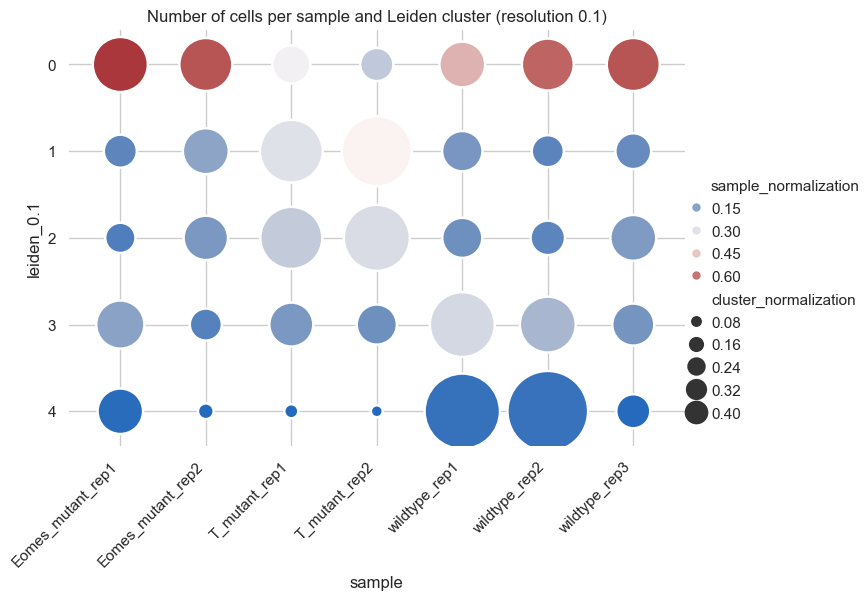

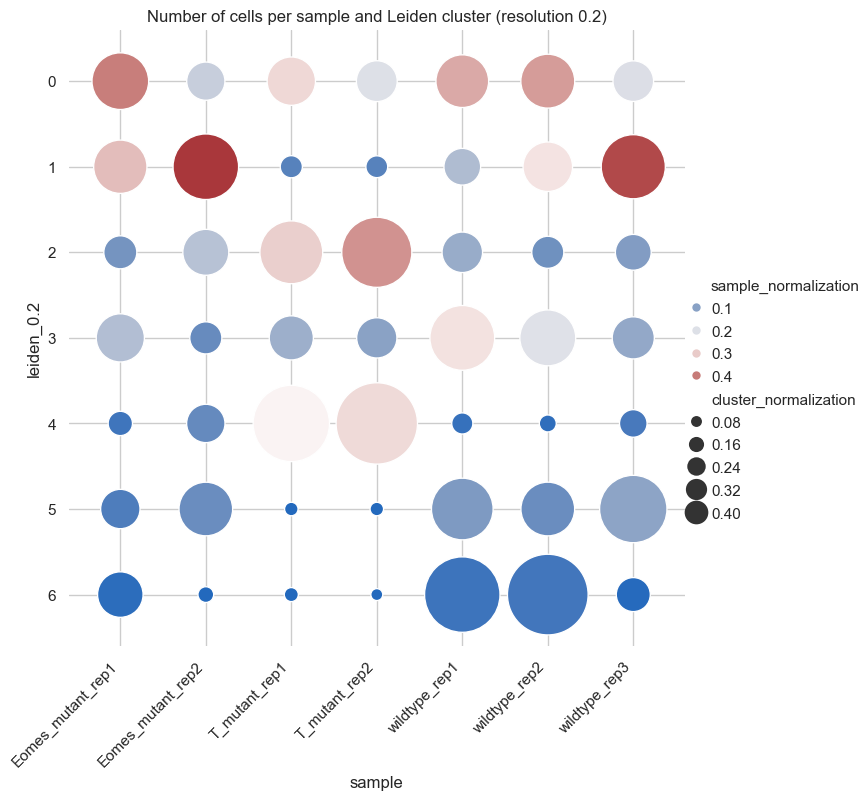

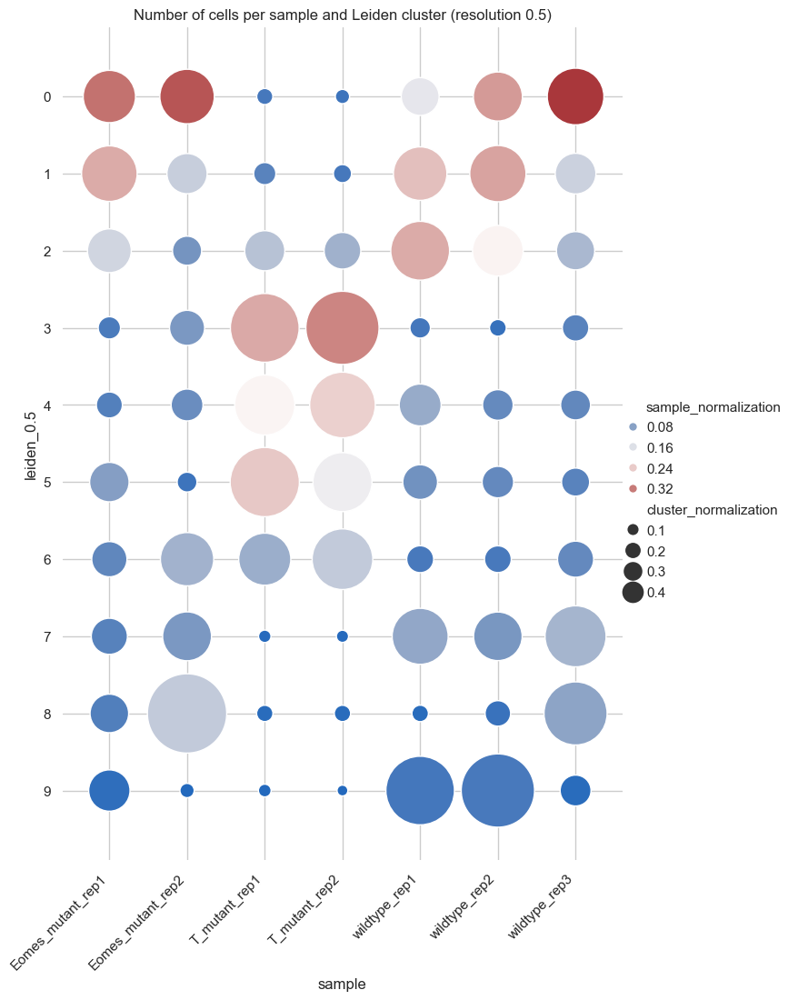

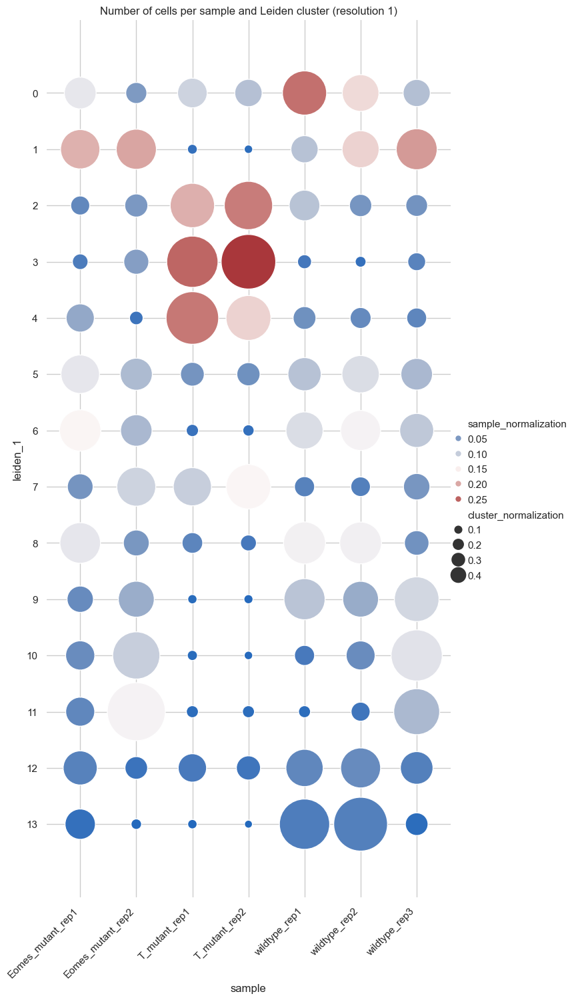

In [33]:
for resolution in parameters["resolutions"]:
    sns.set_theme(style="whitegrid")
    cluster_counts = adata.obs.groupby(["sample", f"leiden_{resolution}"]).size().unstack(fill_value=0)
    shape = cluster_counts.shape
    cluster_counts = cluster_counts.div(cluster_counts.sum(axis=1), axis=0)
    cluster_counts_ = cluster_counts.div(cluster_counts.sum(axis=0), axis=1)
    cluster_counts = cluster_counts.reset_index().melt(id_vars="sample", var_name=f"leiden_{resolution}", value_name="sample_normalization")
    cluster_counts_ = cluster_counts_.reset_index().melt(id_vars="sample", var_name=f"leiden_{resolution}", value_name="cluster_normalization")
    cluster_counts["cluster_normalization"] = cluster_counts_["cluster_normalization"].values
    aspect = shape[0]/shape[1]
    obj = sns.relplot(data=cluster_counts, x="sample", y=f"leiden_{resolution}", 
                      hue="sample_normalization", size="cluster_normalization", 
                      kind="scatter", height=shape[1], aspect=aspect, palette="vlag", 
                      sizes=(50, 8000), size_norm=(0, 1))#, hue_norm=(0, 1))
    for legend_handle in obj.legend.legend_handles:
        legend_handle.set_markersize(max(6,legend_handle.get_markersize()*0.3))

    plt.xticks(rotation=45, ha='right')
    plt.title(f"Number of cells per sample and Leiden cluster (resolution {resolution})")
    obj.ax.margins(.1)
    obj.despine(left=True, bottom=True)
    plt.savefig(f"figures/{dataset_name}/clustermap_leiden_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Density by Condition

/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_30097/3120076028.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = adata.obs.groupby(["condition", f"leiden_{resolution}"]).size().unstack(fill_value=0)
2025-09-18 11:07:15 | [INFO] Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-09-18 11:07:15 | [INFO] Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_30097/3120076028.py:3: FutureWarning: The default of observed=False is deprecate

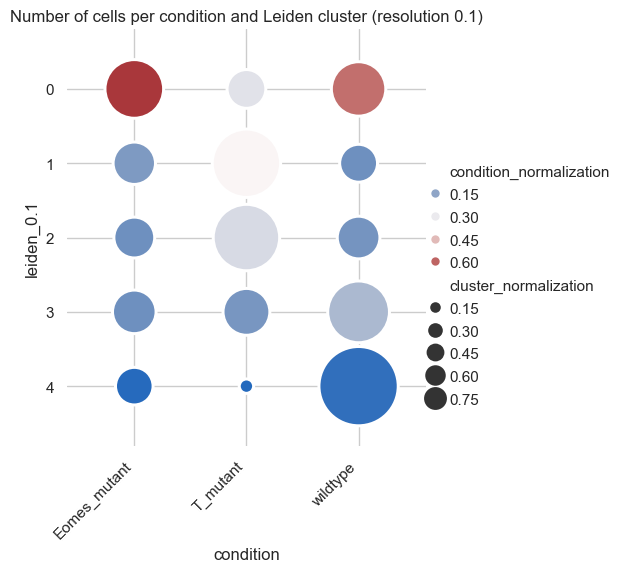

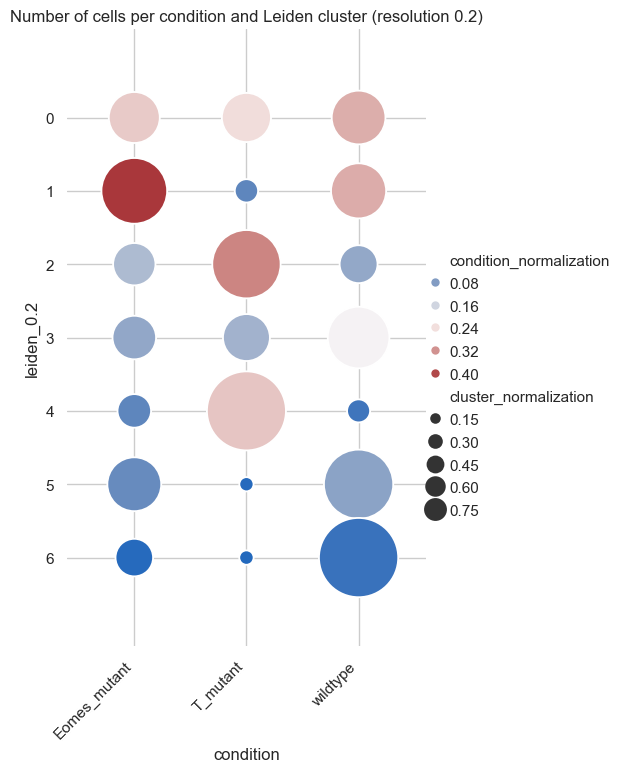

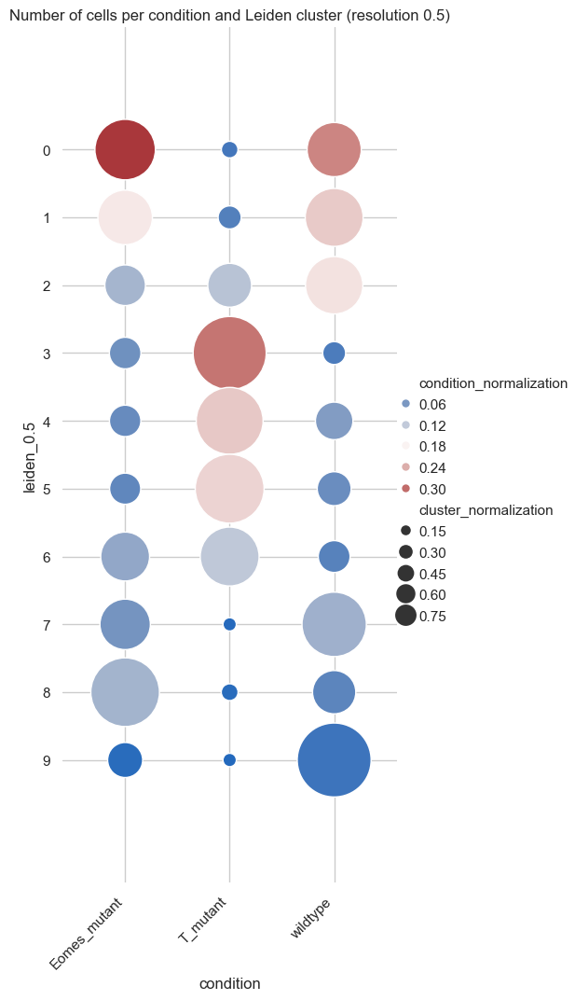

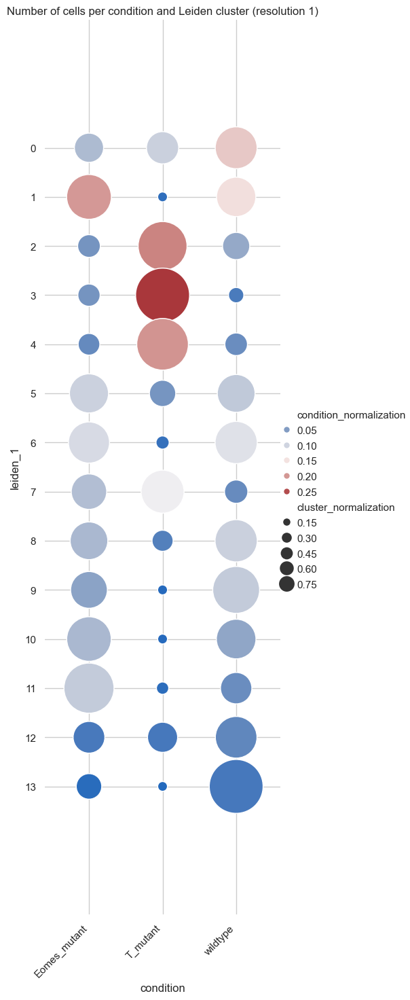

In [34]:
for resolution in parameters["resolutions"]:
    sns.set_theme(style="whitegrid")
    cluster_counts = adata.obs.groupby(["condition", f"leiden_{resolution}"]).size().unstack(fill_value=0)
    shape = cluster_counts.shape
    cluster_counts = cluster_counts.div(cluster_counts.sum(axis=1), axis=0)
    cluster_counts_ = cluster_counts.div(cluster_counts.sum(axis=0), axis=1)
    cluster_counts = cluster_counts.reset_index().melt(id_vars="condition", var_name=f"leiden_{resolution}", value_name="condition_normalization")
    cluster_counts_ = cluster_counts_.reset_index().melt(id_vars="condition", var_name=f"leiden_{resolution}", value_name="cluster_normalization")
    cluster_counts["cluster_normalization"] = cluster_counts_["cluster_normalization"].values
    aspect = shape[0]/shape[1]*1.5
    obj = sns.relplot(data=cluster_counts, x="condition", y=f"leiden_{resolution}", 
                      hue="condition_normalization", size="cluster_normalization", 
                      kind="scatter", height=shape[1], aspect=aspect, palette="vlag", 
                      sizes=(50, 4000), size_norm=(0, 1))#, hue_norm=(0, 1))
    for legend_handle in obj.legend.legend_handles:
        legend_handle.set_markersize(max(6,legend_handle.get_markersize()*0.3))

    plt.xticks(rotation=45, ha='right')
    plt.title(f"Number of cells per condition and Leiden cluster (resolution {resolution})")
    obj.ax.margins(.3,0.2)
    obj.despine(left=True, bottom=True)
    plt.savefig(f"figures/{dataset_name}/clustermap_leiden_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Pathway enrichment analysis

In [37]:
df_pathways = []
with open(f"pathways.json", "r") as f:

    f = json.load(f)

    for pathway, l in f.items():

        for t in ["target", "ligand", "receptor"]:

            df = pd.DataFrame()
            df["target"] = l[t]
            df["source"] = pathway

            df_pathways.append(df)

df_pathways = pd.concat(df_pathways, axis=0)

df_pathways = df_pathways[~df_pathways.duplicated()]

In [38]:
dc.mt.ulm(data=adata, net=df_pathways, tmin=3)

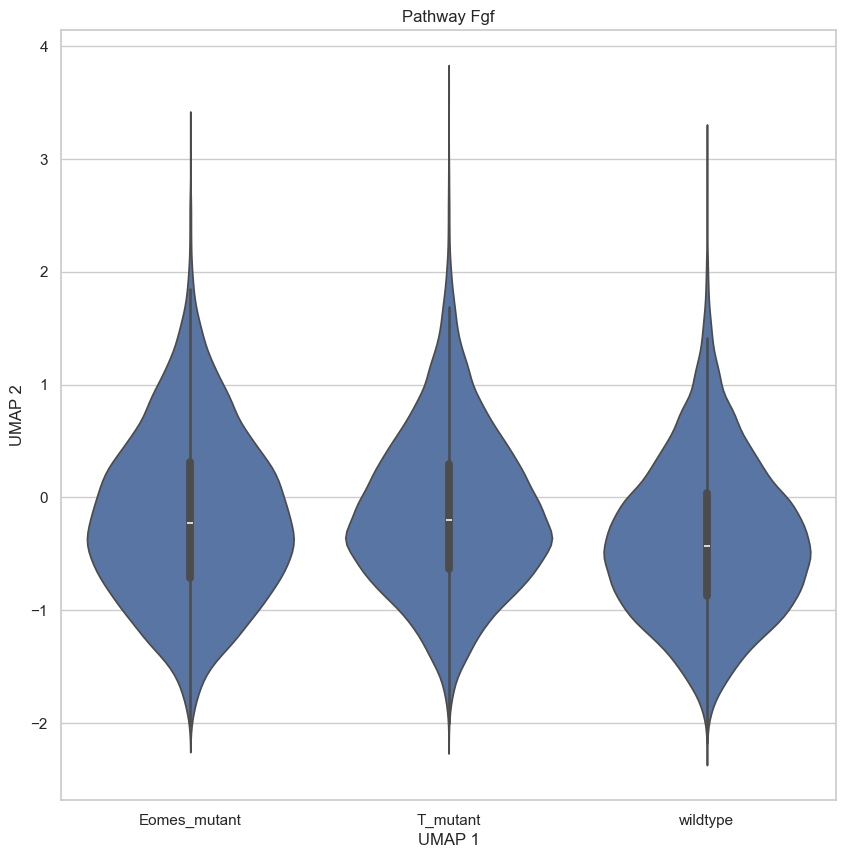

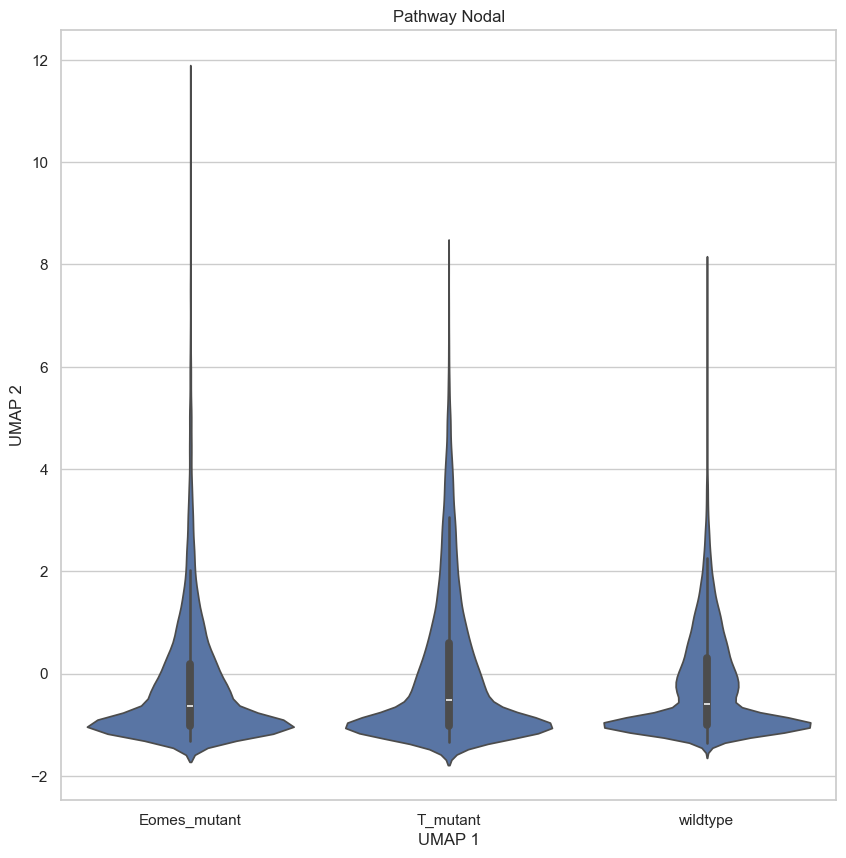

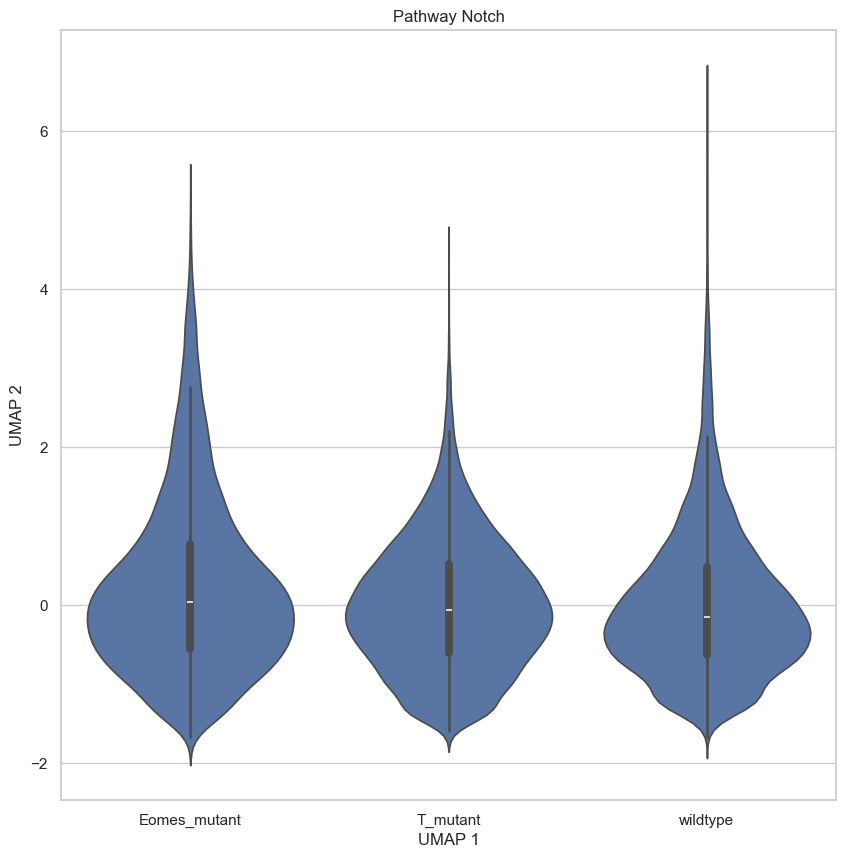

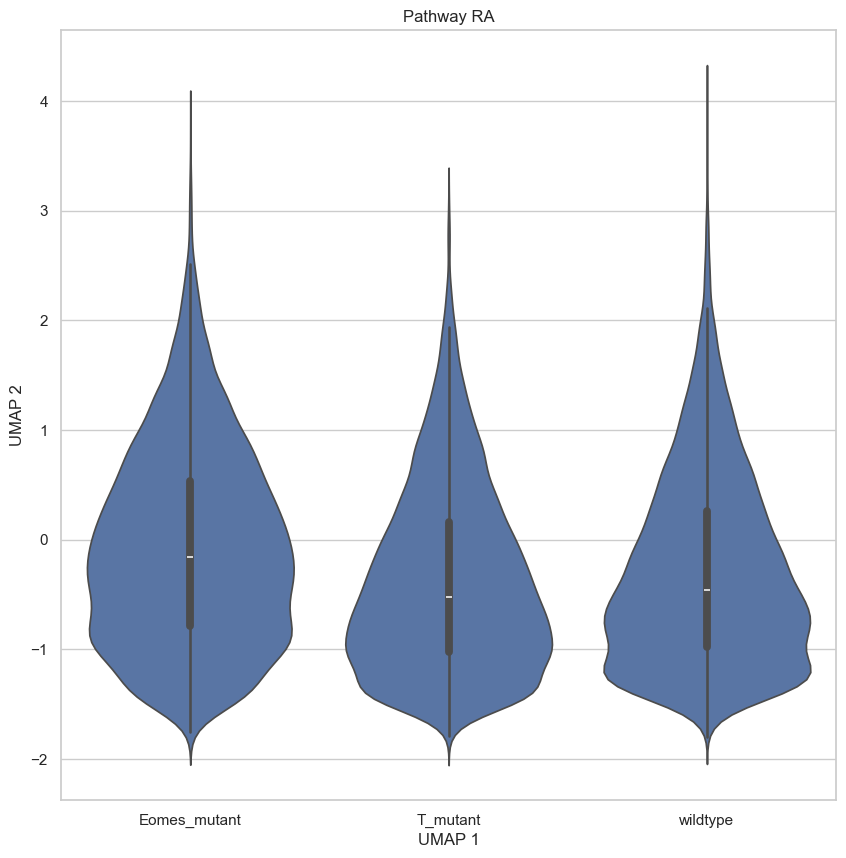

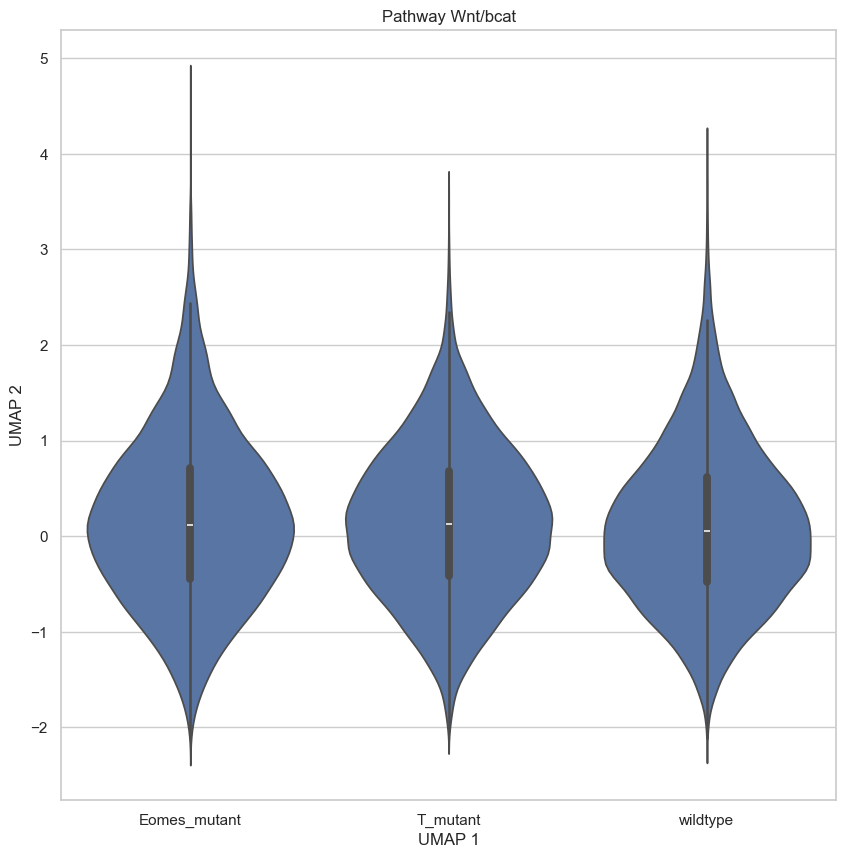

In [39]:
for score in adata.obsm["score_ulm"]:
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))

    X = adata.obsm[f"X_umap_{repr}"]
    x = adata.obs["condition"]
    y = adata.obsm["score_ulm"].loc[:, score]
    sns.violinplot(x=x, y=y, ax=ax, density_norm="width")
    ax.set_title(f"Pathway {score}")
    ax.set_xlabel("UMAP 1")
    ax.set_ylabel("UMAP 2")

    fig.savefig(f"figures/{dataset_name}/pathway_enrichment_violin_condition_{score.replace('/', '_')}.png", bbox_inches="tight", transparent=True, dpi=300)

# Condition comparisons

In [8]:
adata = scp.read(f"data_processed/adata_{dataset_name}.h5ad")

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [9]:
markers = pd.read_csv("markers.csv", header=None).values.flatten().tolist()

## Comparison clusterwise

In [141]:
clusters = adata.obs[f"leiden_1"]
condition = adata.obs["condition"]
columns = markers
X = adata[:,markers].X.toarray()

df = pd.DataFrame(X, columns=columns)
df["cluster"] = clusters.values
df["condition"] = condition.values

/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_93292/1663176864.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_stats = df_plot.groupby(["cluster", "level_3", "condition"])[0].agg(
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_93292/1663176864.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap(cmap_map['wildtype']), norm=hue_norm); sm.set_array([]); cax = fig.add_axes([pos[count], 0.15, 0.005, 0.2]); cbar = plt.colorbar(sm, cax=cax)
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_93292/1663176864.py:62: MatplotlibDeprecationWarnin

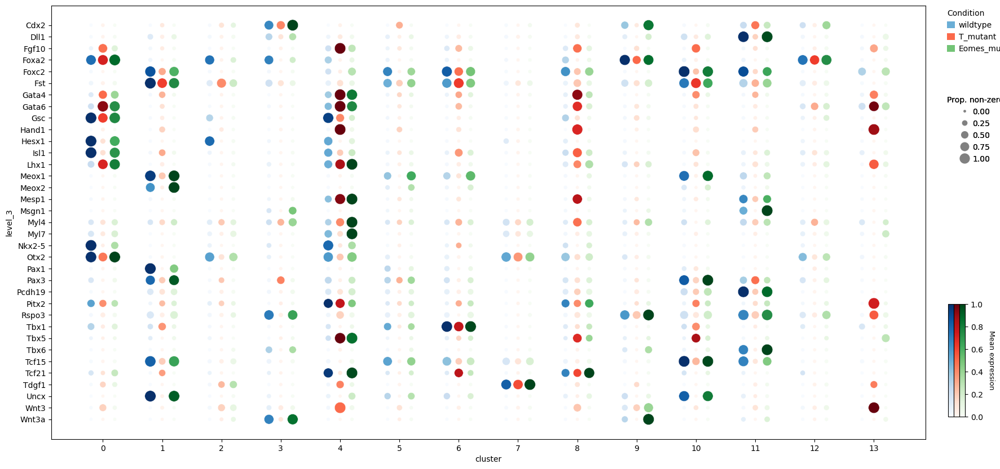

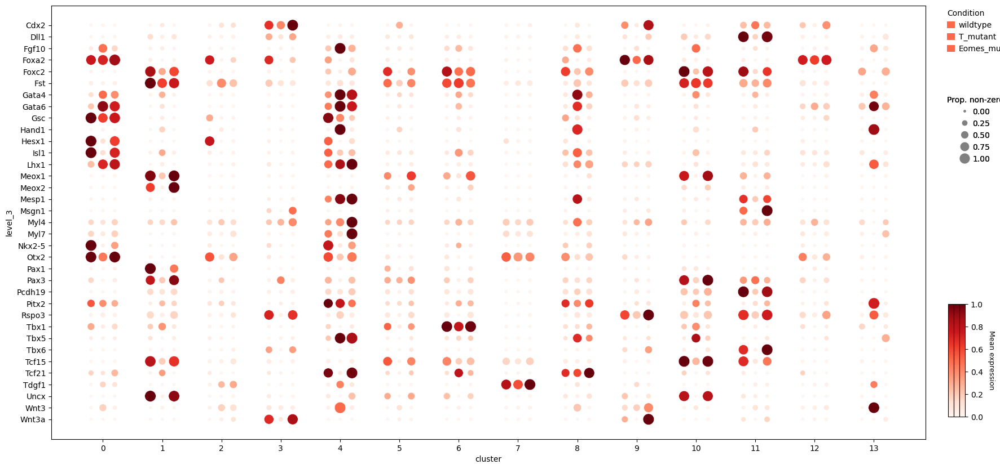

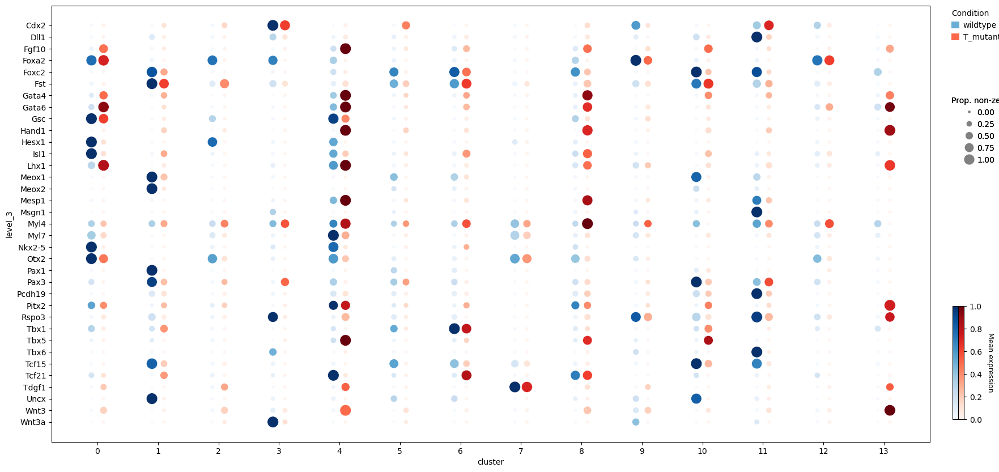

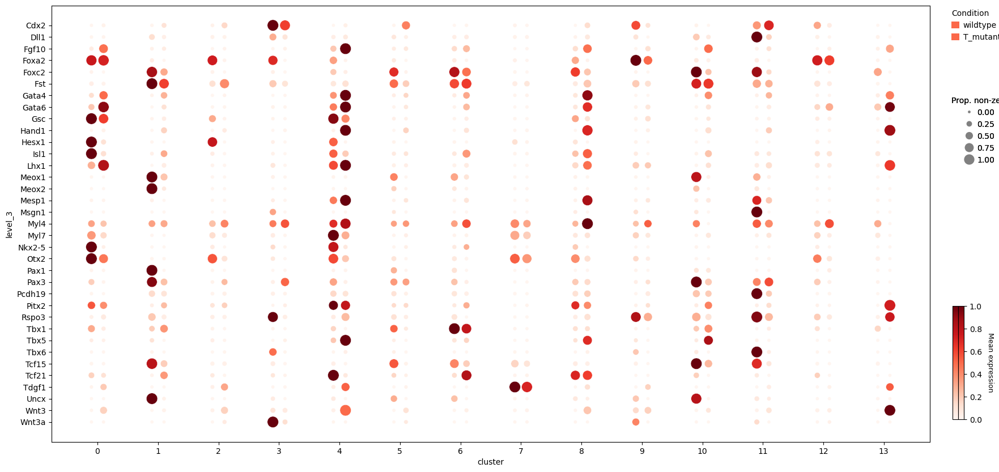

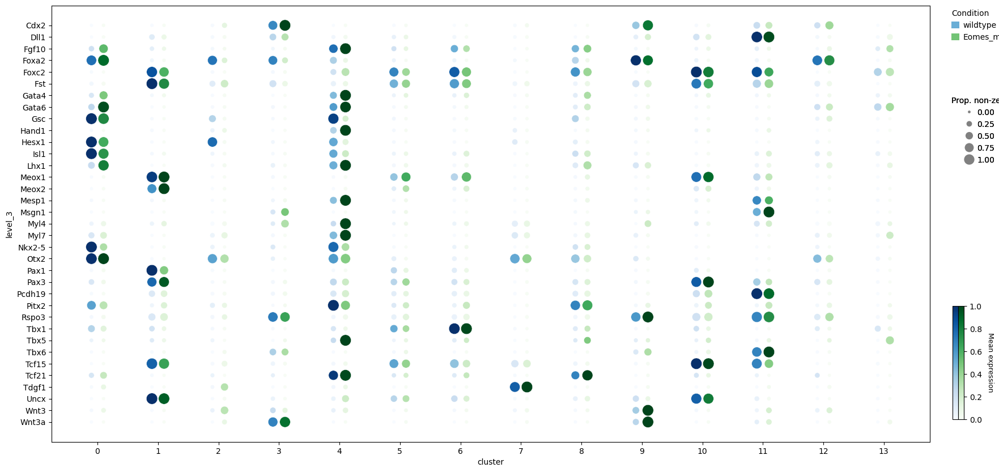

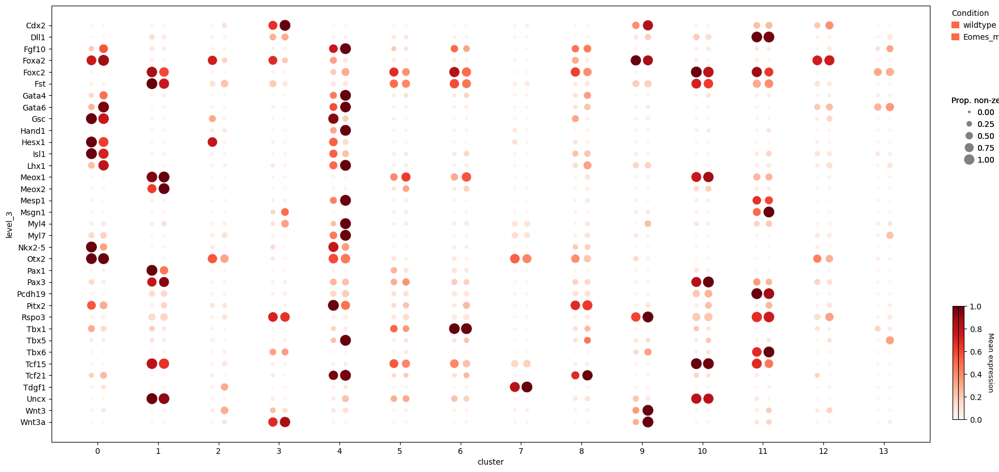

In [155]:
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

for keep, shift_map, cmap_map in [
        (["wildtype", "T_mutant", "Eomes_mutant"], {'wildtype': -0.2, 'T_mutant': 0, 'Eomes_mutant': 0.2}, {'wildtype': 'Blues', 'T_mutant': 'Reds', 'Eomes_mutant': 'Greens'}),
        (["wildtype", "T_mutant", "Eomes_mutant"], {'wildtype': -0.2, 'T_mutant': 0, 'Eomes_mutant': 0.2}, {'wildtype': 'Reds', 'T_mutant': 'Reds', 'Eomes_mutant': 'Reds'}),
        (["wildtype", "T_mutant"], {'wildtype': -0.1, 'T_mutant': 0.1}, {'wildtype': 'Blues', 'T_mutant': 'Reds', 'Eomes_mutant': 'Greens'}),
        (["wildtype", "T_mutant"], {'wildtype': -0.1, 'T_mutant': 0.1}, {'wildtype': 'Reds', 'T_mutant': 'Reds', 'Eomes_mutant': 'Reds'}),
        (["wildtype", "Eomes_mutant"], {'wildtype': -0.1, 'Eomes_mutant': 0.1}, {'wildtype': 'Blues', 'T_mutant': 'Reds', 'Eomes_mutant': 'Greens'}),
        (["wildtype", "Eomes_mutant"], {'wildtype': -0.1, 'Eomes_mutant': 0.1}, {'wildtype': 'Reds', 'T_mutant': 'Reds', 'Eomes_mutant': 'Reds'}),
    ]:

    df_ = df[df["condition"].isin(keep)].copy()

    df_plot = df_.reset_index().set_index(["cluster", "index", "condition"]).stack().reset_index()

    df_stats = df_plot.groupby(["cluster", "level_3", "condition"])[0].agg(
        mean='mean',
        prop_nonzero=lambda x: (x > 0).mean()
    ).reset_index()

    # Normalize 'mean' and 'prop_nonzero' within each marker (level_3) to [0,1]
    for c in ["mean", "prop_nonzero"]:
        df_stats[c] = df_stats.groupby("level_3")[c].transform(
            lambda x: (x - x.min()) / (x.max() - x.min()) if x.max() != x.min() else 0.0
        )

    # Convert cluster to numeric for shifting
    df_stats['cluster_num'] = pd.to_numeric(df_stats['cluster'])

    # Add horizontal shifts for each condition
    # shift_map = {'wildtype': -0.2, 'T_mutant': 0, 'Eomes_mutant': 0.2}
    df_stats['cluster_shifted'] = df_stats['cluster_num'].values.astype(float) + df_stats['condition'].map(shift_map).values.astype(float)

    hue_norm = plt.Normalize(0, df_stats['mean'].max())
    size_norm = plt.Normalize(0, df_stats['prop_nonzero'].max())

    fig, ax = plt.subplots(figsize=(20,10))
    
    sns.scatterplot(data=df_stats[df_stats["condition"]=="wildtype"], x="cluster_shifted", y="level_3", hue="mean", size="prop_nonzero", palette=cmap_map['wildtype'], sizes=(20, 200), size_norm=size_norm, hue_norm=hue_norm, legend=False)
    sns.scatterplot(data=df_stats[df_stats["condition"]=="T_mutant"], x="cluster_shifted", y="level_3", hue="mean", size="prop_nonzero", palette=cmap_map['T_mutant'], sizes=(20, 200), size_norm=size_norm, hue_norm=hue_norm, legend=False)
    sns.scatterplot(data=df_stats[df_stats["condition"]=="Eomes_mutant"], x="cluster_shifted", y="level_3", hue="mean", size="prop_nonzero", palette=cmap_map['Eomes_mutant'], sizes=(20, 200), size_norm=size_norm, hue_norm=hue_norm, legend=False)

    # Fix x-axis to show original cluster numbers
    ax.set_xticks(df_stats['cluster_num'].unique())
    ax.set_xticklabels(df_stats['cluster'].unique())
    ax.set_xlabel('cluster')


    # Create custom legend handles
    # show color intensity example using the wildtype palette and also display palettes for other conditions
    # cmap_map = {'wildtype': 'Blues', 'T_mutant': 'Reds', 'Eomes_mutant': 'Greens'}

    # If you want a single combined note instead (uncomment below and remove the small colorbars above)
    pos = [0.92, 0.925, 0.93]
    count = 0
    if 'wildtype' in keep:
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap(cmap_map['wildtype']), norm=hue_norm); sm.set_array([]); cax = fig.add_axes([pos[count], 0.15, 0.005, 0.2]); cbar = plt.colorbar(sm, cax=cax)
        count += 1
    if 'T_mutant' in keep:
        cbar.set_ticks([])
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap(cmap_map['T_mutant']), norm=hue_norm); sm.set_array([]); cax = fig.add_axes([pos[count], 0.15, 0.005, 0.2]); cbar = plt.colorbar(sm, cax=cax)
        count += 1
    if 'Eomes_mutant' in keep:
        cbar.set_ticks([])
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap(cmap_map['Eomes_mutant']), norm=hue_norm); sm.set_array([]); cax = fig.add_axes([pos[count], 0.15, 0.005, 0.2]); cbar = plt.colorbar(sm, cax=cax)
    cbar.set_label('Mean expression', rotation=270, labelpad=15, fontsize=9)

    # Color legend for conditions
    condition_colors = {'wildtype': sns.color_palette(cmap_map['wildtype'],1)[0], 'T_mutant': sns.color_palette(cmap_map['T_mutant'],1)[0], 'Eomes_mutant': sns.color_palette(cmap_map['Eomes_mutant'],1)[0]}
    condition_colors = {k:v for k,v in condition_colors.items() if k in keep}
    condition_handles = [Patch(facecolor=color, label=condition) 
                        for condition, color in condition_colors.items()]

    # Size legend for proportion
    sizes_to_show = [0.0, 0.25, 0.5, 0.75, 1.0]
    size_handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', 
                        markersize=np.sqrt(20 + (200-20)*s), label=f'{s:.2f}')
                    for s in sizes_to_show]

    # Mean intensity note
    # intensity_handle = [Patch(facecolor='none', edgecolor='none', 
    #                           label='Color intensity = normalized mean')]

    # Combine legends
    legend1 = ax.legend(handles=condition_handles, title='Condition', 
                        loc='upper left', bbox_to_anchor=(1.02, 1))
    # tighten spacing so rotated labels fit better
    legend1._legend_box.align = "left"
    legend2 = ax.legend(handles=size_handles, title='Prop. non-zero', 
                    loc='upper left', bbox_to_anchor=(1.02, 0.8))
    # legend3 = ax.legend(handles=intensity_handle, title='',
    #                    loc='upper left', bbox_to_anchor=(1.02, 0.25))
    ax.add_artist(legend1)
    ax.add_artist(legend2)

    # plt.tight_layout()
    fig.savefig(f"figures/{dataset_name}/marker_expression_by_condition_{'_'.join(keep)}_{'_'.join([c for c in cmap_map.values()])}.png", bbox_inches="tight", transparent=True, dpi=300)





# Save 

## Adata object

In [40]:
adata.write(f"data_processed/adata_{dataset_name}.h5ad")

## Save analysis script

In [156]:
# Get the current date
current_date = datetime.now().strftime("%Y%m%d")

# Construct the output file name with the current date
input_file = f"analysis_full.ipynb"
output_file = f"script_versions/analysis_full_{current_date}"

# Convert the notebook to HTML with the new file name
!jupyter nbconvert --to html "$input_file" --output "$output_file"


[NbConvertApp] Converting notebook analysis_full.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 67 image(s).
[NbConvertApp] Writing 34190610 bytes to script_versions/analysis_full_20251224.html
